In [1]:
import csv
import json
import pandas
import urllib.request
import re
import networkx as nx
import matplotlib.pyplot as plt
import random
from fa2 import ForceAtlas2
import statistics
import os

# Part A

In [2]:
marvelfile = open('marvel.csv')
dcfile = open('dc.csv')

In [3]:
readerM = pandas.read_csv('marvel.csv')
readerD = pandas.read_csv('dc.csv')

In [4]:
lstM = []
empty = 0
for i in range(len(readerM)):
    if pandas.isnull(readerM.iloc[i,2]) or "Missing Link (comics)" == readerM.iloc[i,2] or "SeÃ±or Muerte / SeÃ±or Suerte" == readerM.iloc[i,2]:
        empty = empty + 1
    else:
        
        link = readerM.iloc[i,2].replace(' ','_')
        lstM.append([readerM.iloc[i,2],link,"text"])

In [5]:
lstD = []
empty = 0
for i in range(len(readerD)):
    if pandas.isnull(readerD.iloc[i,2]) or "Missing Link (comics)" == readerD.iloc[i,2]:
        empty = empty + 1
    else:
        link = readerD.iloc[i,2].replace(' ','_')
        lstD.append([readerD.iloc[i,2],link,"text"])

In [6]:
#sætter parametrene, som beskrevet på https://www.mediawiki.org/wiki/API:Tutorial
baseurl = "https://en.wikipedia.org/w/api.php?"
action = "action=query"
content = "prop=revisions&rvprop=content"
dataformat ="format=json"

In [8]:
for i in range(len(lstM)):
    
    if re.match(r".*?(?=\|)",lstM[i][1]) is not None:
        title = "titles={}".format(re.match(r".*?(?=\|)",lstM[i][1]).group(0)) 
    elif re.match(r".*?(?=\#)",lstM[i][1]) is not None:
        title = "titles={}".format(re.match(r".*?(?=\#)",lstM[i][1]).group(0))
    elif re.match(r".*?(?=\/)",lstM[i][1]) is not None:
        #title = "titles={}".format(re.match(r".*?(?=\/)",lstM[i][1]).group(0))
        continue
    else:
        title = "titles={}".format(lstM[i][1])
    
    query = "{}{}&{}&{}&{}".format(baseurl, action, content, title, dataformat)
    wikiresponse = urllib.request.urlopen(query)
    wikidata = wikiresponse.read()
    wikitext = wikidata.decode('utf-8')
    f = open('marvel/' + title.strip('titles=').replace('"','').replace(' ','').replace('/','') + '.txt', 'w')
    f.write("[[[" + lstM[i][0] + "]]]")
    f.write(json.dumps(json.loads(wikitext)))
    

In [7]:
for i in range(len(lstD)):
    
    if re.match(r".*?(?=\|)",lstD[i][1]) is not None:
        title = "titles={}".format(re.match(r".*?(?=\|)",lstD[i][1]).group(0)) 
    elif re.match(r".*?(?=\#)",lstD[i][1]) is not None:
        title = "titles={}".format(re.match(r".*?(?=\#)",lstD[i][1]).group(0))
    elif re.match(r".*?(?=\/)",lstD[i][1]) is not None:
        #title = "titles={}".format(re.match(r".*?(?=\/)",lstM[i][1]).group(0))
        continue
    else:
        title = "titles={}".format(lstD[i][1])
    
    query = "{}{}&{}&{}&{}".format(baseurl, action, content, title, dataformat)
    wikiresponse = urllib.request.urlopen(query)
    wikidata = wikiresponse.read()
    wikitext = wikidata.decode('utf-8')
    f = open('dc/' + title.strip('titles=').replace('"','').replace(' ','').replace('/','') + '.txt', 'w')
    f.write("[[[" + lstD[i][0] + "]]]")
    f.write(json.dumps(json.loads(wikitext)))

# Part b

In [31]:
G = nx.DiGraph()
linksM = []
linksD = []

In [32]:
def search(txt, lst):
    links = []
    matches = re.findall(r"(?<=\[\[).*?(?=\]\])", txt)
    for match in matches:
        for hero in lst:
            if match == hero[0]:
                links.append(hero[0])
    return links

In [33]:
for hero in os.listdir(os.getcwd() + '\\marvel'):
    
    with open(os.path.join(os.getcwd() + '\\marvel', hero), 'r') as file:
        txt = file.read()
        hero_name = re.search(r"(?<=\[\[\[).*?(?=\]\]\])", txt).group(0)
        
        linksM = search(txt, lstM)
        linksD = search(txt, lstD)
        
        G.add_node(hero_name, universe="marvel")
        for link in linksM:
            G.add_node(link, universe="marvel")
            G.add_edge(hero_name, link)
        for link in linksD:
            G.add_node(link,universe="dc")
            G.add_edge(hero_name,link)
        
        file.close()

In [34]:
for hero in os.listdir(os.getcwd() + '\\dc'):
    
    with open(os.path.join(os.getcwd() + '\\dc', hero), 'r') as file:
        txt = file.read()
        hero_name = re.search(r"(?<=\[\[\[).*?(?=\]\]\])", txt)
        if hero_name is None:
            continue
        
        hero_name = hero_name.group(0)
        
        linksM = search(txt, lstM)
        linksD = search(txt, lstD)
        
        G.add_node(hero_name, universe="dc")
        for link in linksM:
            G.add_node(link, universe="marvel")
            G.add_edge(hero_name, link)
        for link in linksD:
            G.add_node(link, universe="dc")
            G.add_edge(hero_name,link)
        
        file.close()

In [36]:
len(G.nodes)

2275

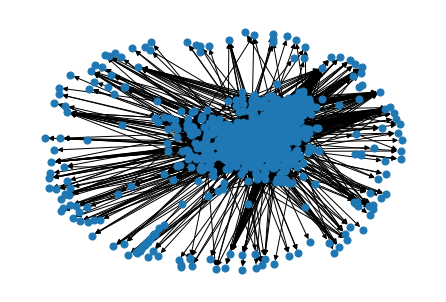

In [16]:
G.remove_nodes_from(list(nx.isolates(G)))
nx.draw(G, node_size=50)

In [37]:
nodeCount = len(G.nodes)
print("number of nodes: {}".format(len(G.nodes)))

number of nodes: 2275


In [38]:
edgeCount = len(G.edges)
print("number of edges: {}".format(len(G.edges)))

number of edges: 11841


In [42]:
crossLinks = 0
for edge in list(G.edges):
    universe1 = G.nodes[edge[0]]['universe']
    universe2 = G.nodes[edge[1]]['universe']
    if universe1 != universe2:
        crossLinks = crossLinks + 1
print("amount of links between marvel and dc: {}".format(crossLinks))

amount of links between marvel and dc: 164


In [43]:
#Creating random network with same amount of nodes and edges
randomG = nx.DiGraph()
for i in range(nodeCount):
    randomG.add_node(i)
for i in range(edgeCount):
    randomG.add_edge(random.choice(list(randomG.nodes)),random.choice(list(randomG.nodes)))

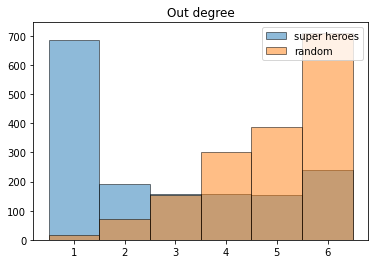

In [44]:
degrees = [G.out_degree(n) for n in G.nodes()]
randomDegrees = [randomG.out_degree(n) for n in randomG.nodes()] 
plt.hist(degrees, edgecolor='black', alpha=0.5,align='right', bins=range(0,7), label='super heroes')
plt.hist(randomDegrees, edgecolor='black', alpha=0.5,align='right', bins=range(0, 7), label='random')
plt.legend(loc='upper right')
plt.title('Out degree')
plt.show()

In [45]:
#Creating a scale free network with same amount of nodes
scalefreeG = nx.scale_free_graph(nodeCount)

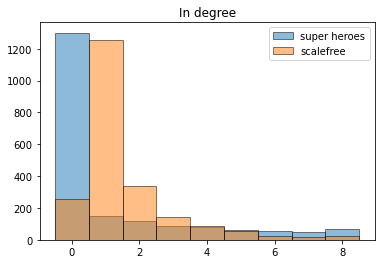

In [46]:
degrees = [G.in_degree(n) for n in G.nodes()]
scalefreeDegrees = [scalefreeG.out_degree(n) for n in scalefreeG.nodes()] 

plt.hist(degrees, edgecolor='black', alpha=0.5,align='left', bins=range(0,10), label='super heroes')
plt.hist(scalefreeDegrees, edgecolor='black', alpha=0.5,align='left', bins=range(0, 10), label='scalefree')
plt.legend(loc='upper right')
plt.title('In degree')
plt.show()

In [47]:
def sortIn(e):
  return e['in']

def sortOut(e):
  return e['out']

marvelNodeDegree = []

for node in G.nodes:
    if G.nodes[node]['universe'] == 'marvel':
        marvelNodeDegree.append({'name':node,'out':G.out_degree(node),'in':G.in_degree(node)})

#sort according to in degree
marvelNodeDegree.sort(key=sortIn)

print("Top 5 marvel in:")
for i in range(len(marvelNodeDegree)-1, len(marvelNodeDegree)-6, -1):
    print("{}: {}".format(marvelNodeDegree[i]['name'],marvelNodeDegree[i]['in']))
    
#sort according to out degree
marvelNodeDegree.sort(key=sortOut)

print("\nTop 5 marvel out:")
for i in range(len(marvelNodeDegree)-1, len(marvelNodeDegree)-6, -1):
    print("{}: {}".format(marvelNodeDegree[i]['name'],marvelNodeDegree[i]['out']))

Top 5 marvel in:
Spider-Man: 397
Doctor Doom: 178
Doctor Strange: 173
She-Hulk: 140
Punisher: 116

Top 5 marvel out:
Iron Man|Iron Man (Ultimate Marvel character)|Tony Stark (Marvel Cinematic Universe): 49
Wolverine (character)|Wolverine (Ultimate Marvel character)|Logan (film series character): 44
She-Hulk: 39
Captain America|Captain America (Ultimate Marvel character)|Steve Rogers (Marvel Cinematic Universe): 38
Norman Osborn|Norman Osborn (Sam Raimi film series): 37


In [48]:
def sortIn(e):
  return e['in']

def sortOut(e):
  return e['out']

marvelNodeDegree = []

for node in G.nodes:
    if G.nodes[node]['universe'] == 'dc':
        marvelNodeDegree.append({'name':node,'out':G.out_degree(node),'in':G.in_degree(node)})

#sort according to in degree
marvelNodeDegree.sort(key=sortIn)

print("Top 5 dc in:")
for i in range(len(marvelNodeDegree)-1, len(marvelNodeDegree)-6, -1):
    print("{}: {}".format(marvelNodeDegree[i]['name'],marvelNodeDegree[i]['in']))
    
#sort according to out degree
marvelNodeDegree.sort(key=sortOut)

print("\nTop 5 dc out:")
for i in range(len(marvelNodeDegree)-1, len(marvelNodeDegree)-6, -1):
    print("{}: {}".format(marvelNodeDegree[i]['name'],marvelNodeDegree[i]['out']))

Top 5 dc in:
Superman: 227
Batman: 222
Wonder Woman: 141
Lex Luthor: 133
Darkseid: 89

Top 5 dc out:
Deathstroke#Origins: 34
Super Friends#Other DC Comics villains: 33
Red Tornado|Red Tornado (identity): 32
Black Adam: 28
Cyborg (DC Comics): 27


In [49]:
def myFunc(e):
  return e['degree']

nodeDegree = []

for node in G.nodes:
    nodeDegree.append({'name':node,'degree':G.degree(node)})

nodeDegree.sort(key=myFunc)

In [50]:
print("Top 5 all degree:")
for i in range(len(nodeDegree)-1, len(nodeDegree)-6, -1):
    print("{}: {}".format(nodeDegree[i]['name'],nodeDegree[i]['degree']))

Top 5 all degree:
Spider-Man: 417
Batman: 243
Superman: 243
Doctor Doom: 213
Doctor Strange: 202


# Week 5

# Part A
Exercise 1

In [51]:
Gsub = max(nx.weakly_connected_components(G))
Gsub = nx.subgraph(G, Gsub)

In [52]:
Gsubud = Gsub.to_undirected()

Exercise 2

In [62]:
defined_colors = []
defined_sizes = []

for node in Gsubud:
    defined_sizes.append(Gsubud.degree(node)*30)
    if Gsubud.nodes[node]['universe'] == 'marvel':
        defined_colors.append("#A83432")
    if Gsubud.nodes[node]['universe'] == 'dc':
        defined_colors.append("#323EA8")


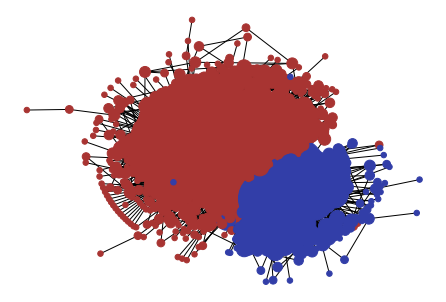

In [63]:
nx.draw_kamada_kawai(Gsubud, node_color=defined_colors, node_size = defined_sizes)

Exercise 3

In [55]:
forceatlas2 = ForceAtlas2(gravity = 2.0)

In [56]:
positions = forceatlas2.forceatlas2_networkx_layout(Gsubud, pos=None, iterations=2000)

100%|██████████████████████████████████████████████████████████████████████████████| 2000/2000 [01:38<00:00, 20.24it/s]

BarnesHut Approximation  took  12.84  seconds
Repulsion forces  took  82.97  seconds
Gravitational forces  took  0.23  seconds
Attraction forces  took  0.37  seconds
AdjustSpeedAndApplyForces step  took  1.04  seconds


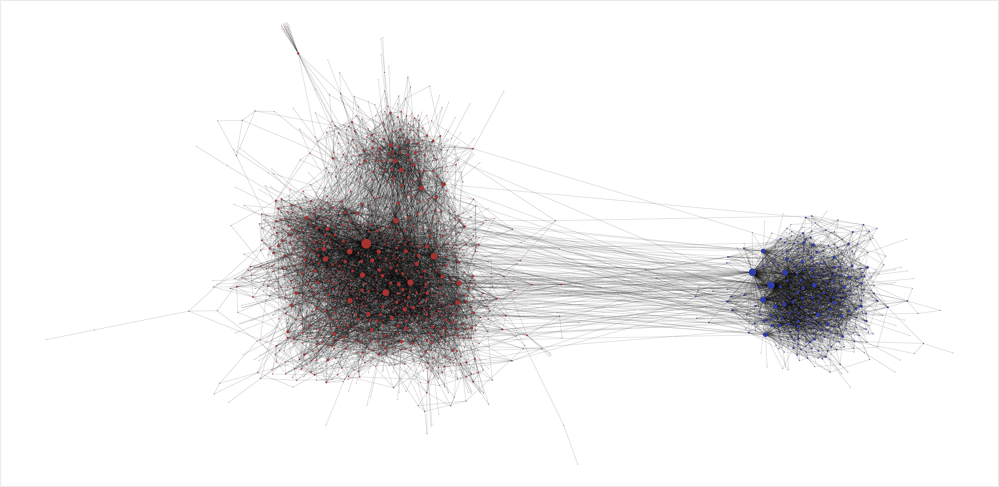

In [64]:
fig = plt.figure(1, figsize=(200, 100), dpi=60)
nx.draw_networkx_nodes(Gsubud, positions, node_size = defined_sizes, alpha=1, node_color = defined_colors)
nx.draw_networkx_edges(Gsubud, positions, alpha=1)

Exercise 4

Spider-Man is the hero with highest in-degree, Iron Man highest out degree.

In [70]:
to_SpiderMan = []
from_IronMan = []
for edge in list(G.edges()):
    if edge[1] == 'Spider-Man':
        to_SpiderMan.append(edge[0])
    if edge[0] == 'Iron Man|Iron Man (Ultimate Marvel character)|Tony Stark (Marvel Cinematic Universe)':
        from_IronMan.append(edge[1])

In [71]:
to_SpiderMan

['Jimmy Woo',
 'Abigail Brand',
 'Maria Hill',
 'Beta Ray Bill',
 'Henry Peter Gyrich',
 "Death's Head",
 'Rocket Raccoon',
 'Living Laser',
 'Kang the Conqueror',
 'Abner Jenkins',
 'Helmut Zemo',
 'Luke Cage',
 'Man-Thing',
 'Erik Josten',
 'Abomination (character)',
 'Silver Surfer',
 'Beyonder',
 'She-Hulk',
 'Nate Grey',
 'Doctor Strange',
 'Marlo Chandler',
 'Doctor Doom',
 'Doc Samson',
 'Absorbing Man',
 'Kamala Khan',
 'Superman',
 'Deadpool',
 'Black Bolt',
 'Ethan Edwards',
 'Stilt-Man',
 'Red Skull',
 'Ultron',
 'Machine Man',
 'High Evolutionary',
 'Man-Beast',
 'Devil Dinosaur',
 'Supreme Intelligence',
 'Cosmo the Spacedog',
 'Emma Frost',
 'Annihilus',
 'Carol Danvers',
 'Punisher',
 'Korvac',
 'Mad Thinker',
 'J. Jonah Jameson',
 'Mole Man',
 'Alistair Smythe',
 'Spencer Smythe',
 'Spider-Slayer',
 'Lady Octopus',
 'Doctor Octopus',
 'Richard Fisk',
 'Silvermane',
 'Max Modell',
 'Ben Urich',
 'Jessica Jones',
 'Amadeus Cho',
 'Psycho-Man',
 'Iron Man 2020',
 'Mysterio

In [72]:
from_IronMan

['War Machine',
 'Pepper Potts',
 'Spider-Man',
 'Howard Stark',
 'Maria Stark',
 'Wong-Chu',
 'Crimson Dynamo',
 'Titanium Man',
 'Justin Hammer',
 'Bethany Cabe',
 'Doctor Doom',
 'Stilt-Man',
 'Kang the Conqueror',
 'Immortus',
 'Rumiko Fujikawa',
 'Living Laser',
 'Professor X',
 'Mister Fantastic',
 'Black Bolt',
 'Doctor Strange',
 'Ultron',
 'Maria Hill',
 'Daken',
 'Edwin Jarvis',
 'Grey Gargoyle',
 'F.R.I.D.A.Y.',
 'Awesome Android',
 'H.E.R.B.I.E.',
 'Machine Man',
 'Machinesmith',
 'Super-Adaptoid',
 'Sunset Bain',
 'Adam Warlock',
 'Galactus',
 'Red Ronin',
 'Ant-Man',
 'Doctor Octopus',
 'J.A.R.V.I.S.',
 'Madame Masque',
 'Titannus',
 'Luke Cage',
 'Freedom Ring',
 'Baron Zemo',
 'Silver Surfer',
 'Ghost Rider',
 'Green Lantern',
 'Captain Atom',
 'Green Arrow',
 'Wonder Woman']

# Part B
Exercise 5

In [78]:
marvelIn = [G.in_degree(x) for x,y in G.nodes(data=True) if y['universe']=='marvel']
avgInM = statistics.mean(marvelIn)
medianInM = statistics.median(marvelIn)
maxInM = max(marvelIn)
minInM = min(marvelIn)

marvelOut = [G.out_degree(x) for x,y in G.nodes(data=True) if y['universe']=='marvel']
avgOutM = statistics.mean(marvelOut)
medianOutM = statistics.median(marvelOut)
maxOutM = max(marvelOut)
minOutM = min(marvelOut)
print('Marvel statistics:\n')
print('The average in degree: {}'.format(avgInM))
print('The median in degree: {}'.format(medianInM))
print('The max in degree: {}'.format(maxInM))
print('The min in degree: {}\n'.format(minInM))

print('The average out degree: {}'.format(avgOutM))
print('The median out degree: {}'.format(medianOutM))
print('The max out degree: {}'.format(maxOutM))
print('The min out degree: {}\n'.format(minOutM))

Marvel statistics:

The average in degree: 4.855121675155631
The median in degree: 0
The max in degree: 397
The min in degree: 0

The average out degree: 4.8868138087153365
The median out degree: 3
The max out degree: 49
The min out degree: 0



In [79]:
dcIn = [G.in_degree(x) for x,y in G.nodes(data=True) if y['universe']=='dc']
avgInD = statistics.mean(dcIn)
medianInD = statistics.median(dcIn)
maxInD = max(dcIn)
minInD = min(dcIn)

dcOut = [G.out_degree(x) for x,y in G.nodes(data=True) if y['universe']=='dc']
avgOutD = statistics.mean(dcOut)
medianOutD = statistics.median(dcOut)
maxOutD = max(dcOut)
minOutD = min(dcOut)
print('DC statistics:\n')
print('The average in degree: {}'.format(avgInD))
print('The median in degree: {}'.format(medianInD))
print('The max in degree: {}'.format(maxInD))
print('The min in degree: {}\n'.format(minInD))

print('The average out degree: {}'.format(avgOutD))
print('The median out degree: {}'.format(medianOutD))
print('The max out degree: {}'.format(maxOutD))
print('The min out degree: {}\n'.format(minOutD))

DC statistics:

The average in degree: 6.421259842519685
The median in degree: 0.0
The max in degree: 227
The min in degree: 0

The average out degree: 6.311023622047244
The median out degree: 5.0
The max out degree: 34
The min out degree: 0



In [80]:
allIn = [G.in_degree(x) for x,y in G.nodes(data=True)]
avgIn = statistics.mean(allIn)
medianIn = statistics.median(allIn)
maxIn = max(allIn)
minIn = min(allIn)

allOut = [G.out_degree(x) for x,y in G.nodes(data=True)]
avgOut = statistics.mean(allOut)
medianOut = statistics.median(allOut)
maxOut = max(allOut)
minOut = min(allOut)

print('Statistics for all:\n')
print('The average in degree: {}'.format(avgIn))
print('The median in degree: {}'.format(medianIn))
print('The max in degree: {}'.format(maxIn))
print('The min in degree: {}\n'.format(minIn))

print('The average out degree: {}'.format(avgOut))
print('The median out degree: {}'.format(medianOut))
print('The max out degree: {}'.format(maxOut))
print('The min out degree: {}\n'.format(minOut))

Statistics for all:

The average in degree: 5.204835164835165
The median in degree: 0
The max in degree: 397
The min in degree: 0

The average out degree: 5.204835164835165
The median out degree: 3
The max out degree: 49
The min out degree: 0

